# Detecting football players using YOLOv9


![image](https://images.pexels.com/photos/3448246/pexels-photo-3448246.jpeg?auto=compress&cs=tinysrgb&w=600)

## Overview

- **Data Collection**: We will download a dataset containing images and videos of players from Roboflow.
- **Model Training**: Using YOLOv9, we will train a custom model on the dataset to accurately detect the players.
- **Model Evaluation**: We will evaluate the trained model's performance using validation images and videos.
- **Inference**: Finally, we will perform inference on new images and videos to detect in real-world scenarios.

## Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [1]:
!nvidia-smi

Thu May  9 19:30:27 2024       

+---------------------------------------------------------------------------------------+

| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |

|-----------------------------------------+----------------------+----------------------+

| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |

| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |

|                                         |                      |               MIG M. |

|=========================================+======================+======================|

|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |

| N/A   40C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |

|                                         |                      |                  N/A |

+-----------------------------------------+--------------

**NOTE:** To make it easier for us to manage datasets, images and models we create a `HOME` constant.

In [2]:
import os
HOME = os.getcwd()
print(HOME)

/content


## Clone and Install

**NOTE:** YOLOv9 is very new. At the moment, we recommend using a fork of the main repository. The `detect.py` script contains a bug that prevents inference. This bug is patched in the fork.

In [3]:
!git clone https://github.com/SkalskiP/yolov9.git
%cd yolov9
!pip install -r requirements.txt -q

Cloning into 'yolov9'...

remote: Enumerating objects: 325, done.

remote: Counting objects: 100% (216/216), done.

remote: Compressing objects: 100% (61/61), done.

remote: Total 325 (delta 158), reused 155 (delta 155), pack-reused 109

Receiving objects: 100% (325/325), 2.23 MiB | 9.86 MiB/s, done.

Resolving deltas: 100% (165/165), done.

/content/yolov9

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 1.8 MB/s eta 0:00:00

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 1.2 MB/s eta 0:00:00

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 11.7 MB/s eta 0:00:00



**NOTE:** Let's install the [`roboflow`](https://pypi.org/project/roboflow) package, which we will use to download our dataset from [Roboflow Universe](https://universe.roboflow.com/).

In [4]:
!pip install -q roboflow

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.6/74.6 kB 1.3 MB/s eta 0:00:00a 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 3.5 MB/s eta 0:00:00

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 12.3 MB/s eta 0:00:00

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 7.2 MB/s eta 0:00:00

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 12.3 MB/s eta 0:00:00

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 6.6 MB/s eta 0:00:00



## Download model weights

**NOTE:** In the YOLOv9 paper, versions `yolov9-s` and `yolov9-m` are also mentioned, but the weights for these models are not yet available in the YOLOv9 [repository](https://github.com/WongKinYiu/yolov9).

In [5]:
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-c.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-e.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/gelan-c.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/gelan-e.pt

In [6]:
!ls -la {HOME}/weights

total 402440

drwxr-xr-x 2 root root      4096 May  9 19:33 .

drwxr-xr-x 1 root root      4096 May  9 19:33 ..

-rw-r--r-- 1 root root  51508261 Feb 18 12:36 gelan-c.pt

-rw-r--r-- 1 root root 117203713 Feb 18 12:36 gelan-e.pt

-rw-r--r-- 1 root root 103153312 Feb 18 12:36 yolov9-c.pt

-rw-r--r-- 1 root root 140217688 Feb 18 12:36 yolov9-e.pt


## Download the dataset

**NOTE:** The dataset must be saved inside the `{HOME}/yolov9` directory, otherwise, the training will not succeed.

In [7]:
%cd {HOME}/yolov9

/content/yolov9


In [8]:
import roboflow

roboflow.login()

rf = roboflow.Roboflow()

project = rf.workspace("roboflow-jvuqo").project("football-players-detection-3zvbc")
version = project.version(9)
dataset = version.download("yolov9")

visit https://app.roboflow.com/auth-cli to get your authentication token.

Paste the authentication token here: ··········

loading Roboflow workspace...

loading Roboflow project...




Extracting Dataset Version Zip to football-players-detection-9 in yolov9:: 100%|██████████| 636/636 [00:00<00:00, 2192.34it/s]


### Display Random pre_detected Images & video

---



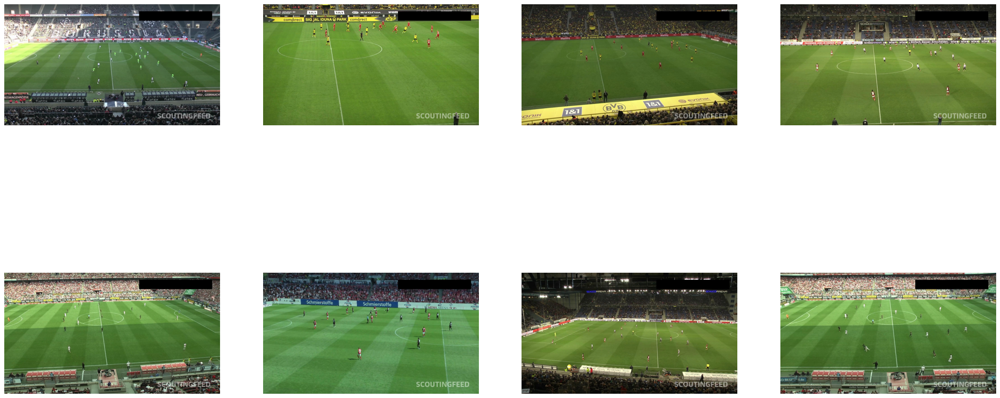

In [9]:
import random
import matplotlib.pyplot as plt
from PIL import Image

# Path to the images folder
images_folder = '/content/yolov9/football-players-detection-9/train/images'

# Function to load and display images
def display_images(image_paths):
    fig, axes = plt.subplots(2, 4, figsize=(30, 15))
    axes = axes.flatten()
    for i, image_path in enumerate(image_paths):
        image = Image.open(image_path)
        axes[i].imshow(image)
        axes[i].axis('off')
    plt.show()

# Get a list of all image paths in the training folder
image_paths = [os.path.join(images_folder, filename) for filename in os.listdir(images_folder) if filename.endswith('.jpg')]

# Shuffle the list of image paths
random.shuffle(image_paths)

# Select 8 random image paths
random_image_paths = image_paths[:8]

# Display the random images
display_images(random_image_paths)

In [1]:
import glob
from IPython.display import HTML
from base64 import b64encode

def play_video(filename, video_title):
    html = ''
    video = open(filename,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += f'<div style="text-align:center;">'
    html += f'<h3>{video_title}</h3>'
    html += '<video width=800 controls autoplay loop><source src="%s" type="video/mp4"></video>' % src
    return HTML(html)

In [5]:
play_video('/kaggle/input/players-detection/Vid2.mp4', "Original Video")

## Train Custom Model

In [12]:
!python train.py \
--batch 16 --epochs 25 --img 640 --device 0 --min-items 0 --close-mosaic 15 \
--data {dataset.location}/data.yaml \
--weights {HOME}/weights/gelan-c.pt \
--cfg models/detect/gelan-c.yaml \
--hyp hyp.scratch-high.yaml

2024-05-09 19:34:35.720577: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered

2024-05-09 19:34:35.720648: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered

2024-05-09 19:34:35.722934: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered

2024-05-09 19:34:37.547381: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT

train: weights=/content/weights/gelan-c.pt, cfg=models/detect/gelan-c.yaml, data=/content/yolov9/football-players-detection-9/data.yaml, hyp=hyp.scratch-high.yaml, epochs=25, batch_size=16, imgsz=640, rect=False, resume=False, nosave=Fal

## Examine Training Results

**NOTE:** By default, the results of each subsequent training sessions are saved in `{HOME}/yolov9/runs/train/`, in directories named `exp`, `exp2`, `exp3`, ... You can override this behavior by using the `--name` parameter.

In [13]:
!ls {HOME}/yolov9/runs/train/exp/

confusion_matrix.png				    P_curve.png       train_batch2.jpg

events.out.tfevents.1715283278.3e7e01b22704.1976.0  PR_curve.png      val_batch0_labels.jpg

F1_curve.png					    R_curve.png       val_batch0_pred.jpg

hyp.yaml					    results.csv       val_batch1_labels.jpg

labels_correlogram.jpg				    results.png       val_batch1_pred.jpg

labels.jpg					    train_batch0.jpg  weights

opt.yaml					    train_batch1.jpg


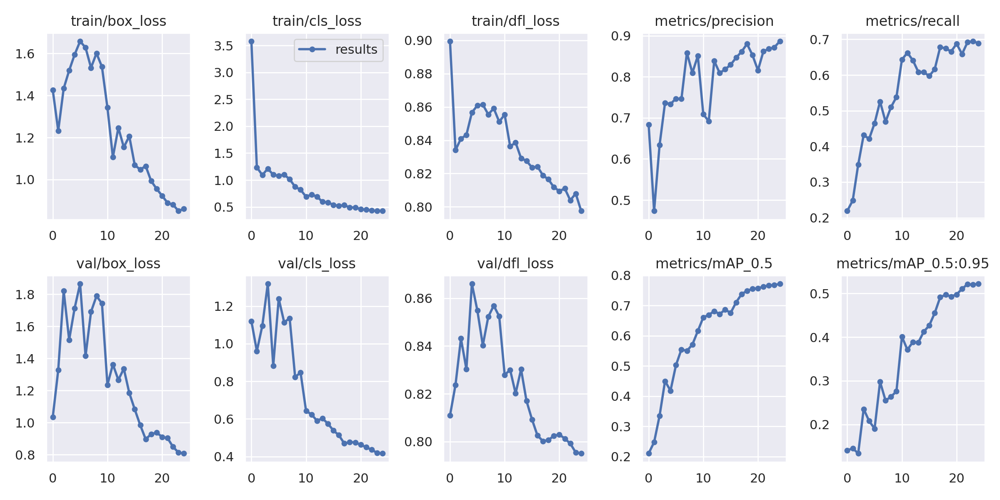

In [14]:
from IPython.display import Image

Image(filename=f"{HOME}/yolov9/runs/train/exp/results.png", width=1000)

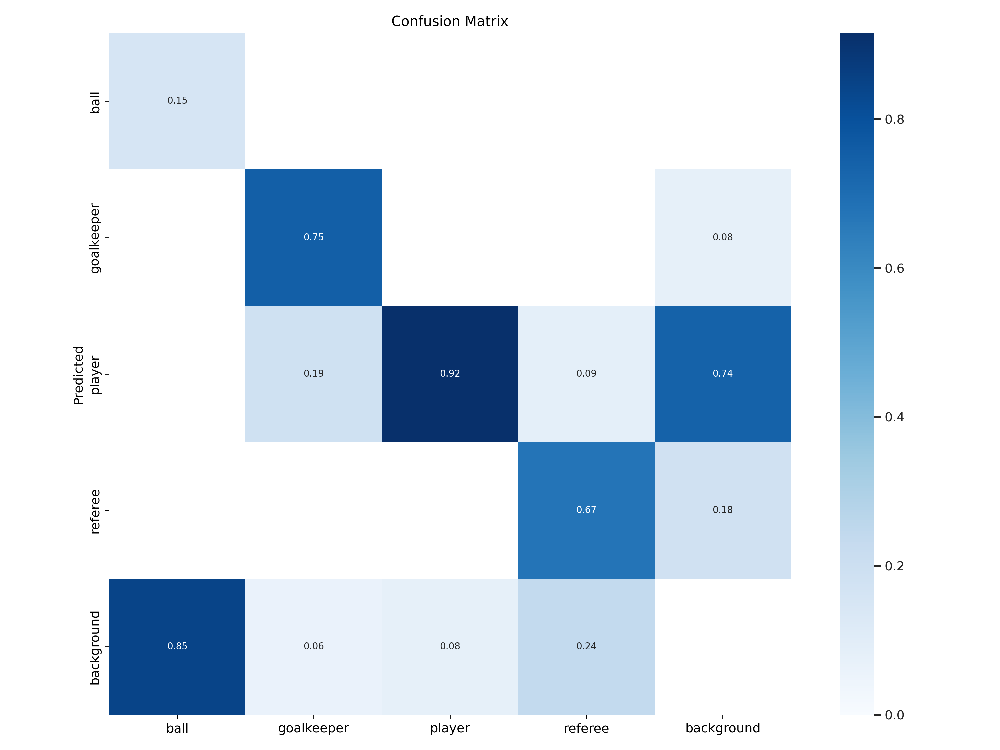

In [15]:
from IPython.display import Image

Image(filename=f"{HOME}/yolov9/runs/train/exp/confusion_matrix.png", width=1000)

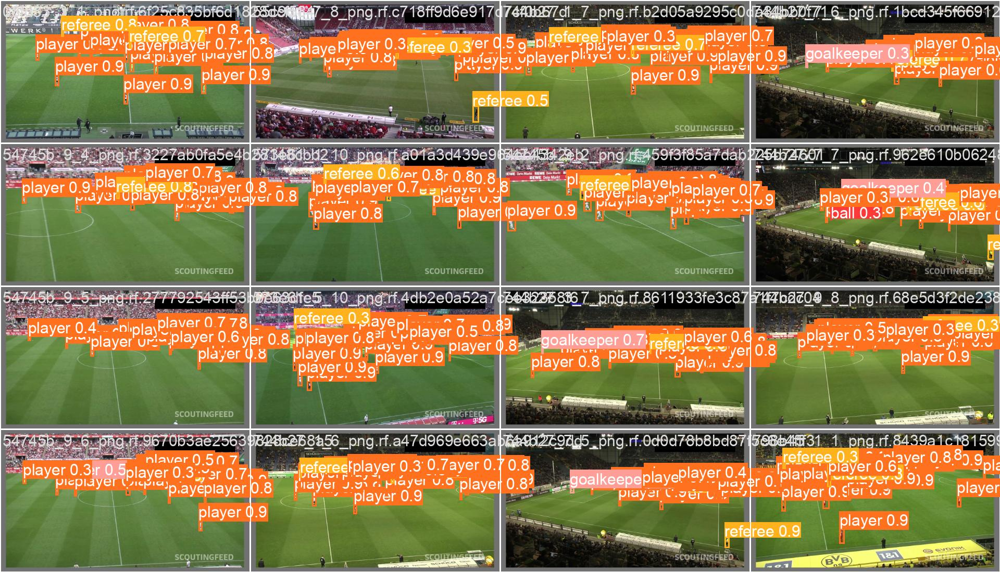

In [16]:
from IPython.display import Image

Image(filename=f"{HOME}/yolov9/runs/train/exp/val_batch0_pred.jpg", width=1000)

## Validate Custom Model

In [17]:
%cd {HOME}/yolov9

!python val.py \
--img 640 --batch 32 --conf 0.001 --iou 0.7 --device 0 \
--data {dataset.location}/data.yaml \
--weights {HOME}/yolov9/runs/train/exp/weights/best.pt

/content/yolov9

val: data=/content/yolov9/football-players-detection-9/data.yaml, weights=['/content/yolov9/runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.7, max_det=300, task=val, device=0, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False, min_items=0

YOLOv5 🚀 1e33dbb Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)



Fusing layers... 

gelan-c summary: 467 layers, 25414044 parameters, 0 gradients, 102.5 GFLOPs

val: Scanning /content/yolov9/football-players-detection-9/valid/labels.cache... 43 images, 0 backgrounds, 0 corrupt: 100% 43/43 [00:00<?, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.

  self.pid = os.fork()


## Inference with Custom Model

In [18]:
!python detect.py \
--img 1280 --conf 0.1 --device 0 \
--weights {HOME}/yolov9/runs/train/exp/weights/best.pt \
--source {dataset.location}/test/images

detect: weights=['/content/yolov9/runs/train/exp/weights/best.pt'], source=/content/yolov9/football-players-detection-9/test/images, data=data/coco128.yaml, imgsz=[1280, 1280], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=0, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1

YOLOv5 🚀 1e33dbb Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)



Fusing layers... 

gelan-c summary: 467 layers, 25414044 parameters, 0 gradients, 102.5 GFLOPs

image 1/19 /content/yolov9/football-players-detection-9/test/images/08fd33_3_6_png.rf.8be10169272238a48652496ad4824d2e.jpg: 736x1280 1 ball, 20 players, 3 referees, 118.9ms

image 2/19 /content/yolov9/football-players-detection-9/test/images/40cd38_7_6_png.rf.68ef7fcd663cdf0f5b96bacdbcd94e07

**NOTE:** Just like before, the inference results have been saved in the appropriate directory inside `{HOME}/yolov9/runs/detect/`. Let's examine few of those results.

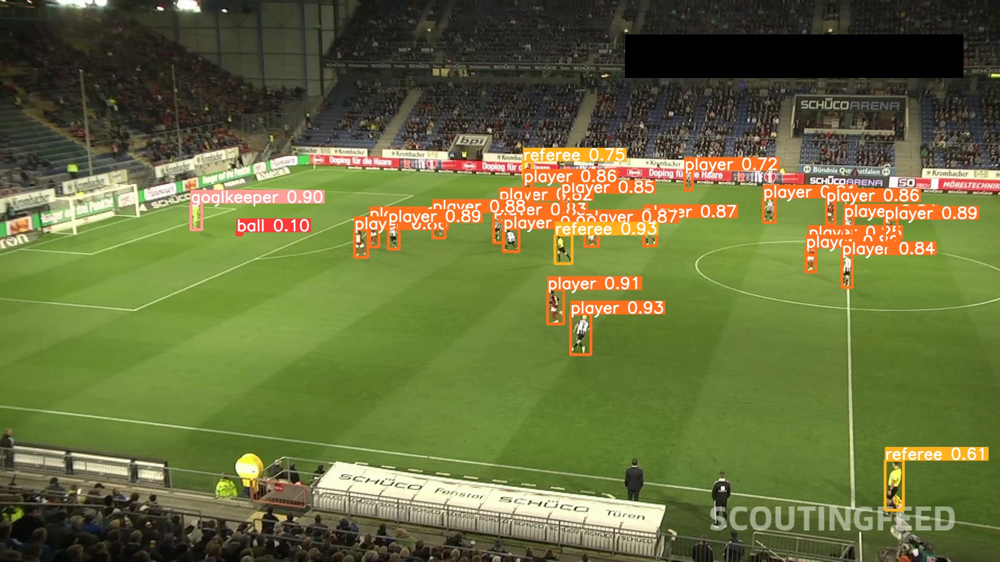

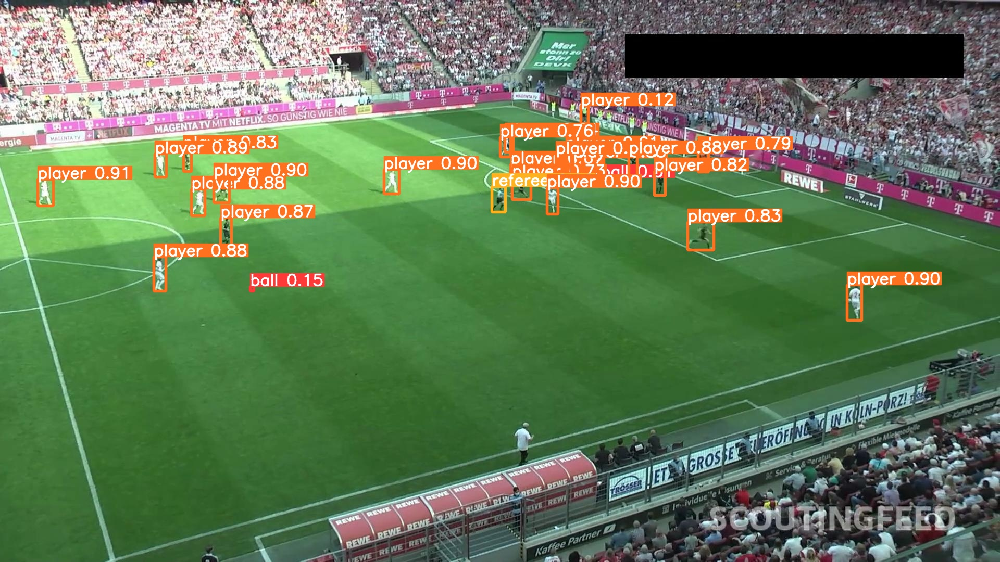

In [24]:
import glob

from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/yolov9/runs/detect/exp/*.jpg')[:2]:
      display(Image(filename=image_path, width=600))

In [20]:
# Detect some test videos
!python detect.py \
--img 1280 --conf 0.1 --device 0 \
--weights {HOME}/yolov9/runs/train/exp/weights/best.pt \
--source /content/yolov9/Vid2.mp4

detect: weights=['/content/yolov9/runs/train/exp/weights/best.pt'], source=/content/yolov9/Vid2.mp4, data=data/coco128.yaml, imgsz=[1280, 1280], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=0, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1

YOLOv5 🚀 1e33dbb Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)



Fusing layers... 

gelan-c summary: 467 layers, 25414044 parameters, 0 gradients, 102.5 GFLOPs

video 1/1 (1/420) /content/yolov9/Vid2.mp4: 736x1280 21 players, 3 referees, 119.9ms

video 1/1 (2/420) /content/yolov9/Vid2.mp4: 736x1280 2 balls, 20 players, 2 referees, 61.1ms

video 1/1 (3/420) /content/yolov9/Vid2.mp4: 736x1280 1 ball, 22 players, 2 referees, 61.0ms

video 1/1 (4/420) /content/yolov9/Vid2.mp4: 736x128

In [4]:
play_video('/kaggle/input/players-detection/Vid_detected.mp4', "Tested_Video")

# How to Train YOLOv9 on a Custom Dataset
---

[![Roboflow](https://raw.githubusercontent.com/roboflow-ai/notebooks/main/assets/badges/roboflow-blogpost.svg)](https://blog.roboflow.com/train-yolov9-model/)
[![GitHub](https://badges.aleen42.com/src/github.svg)](https://github.com/WongKinYiu/yolov9)
[![YouTube](https://badges.aleen42.com/src/youtube.svg)](https://youtu.be/XHT2c8jT3Bc)
[![arXiv](https://img.shields.io/badge/arXiv-2402.13616-b31b1b.svg)](https://arxiv.org/pdf/2402.13616.pdf)

# Made by: Abdelrahman Tarek
**check my github**
[![GitHub](https://badges.aleen42.com/src/github.svg)](https://github.com/Abdelrhmantarekabdelmawla)

**Connect with me on** [LinkedIn](https://www.linkedin.com/in/abdelrhman-tarek/) 🌐

**don't forget to upvote if you liked it....and Thanks**